In [30]:
import pandas as pd
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt
import scipy.ndimage as ndi
from nilearn import plotting
import os

# Raw and mask generated by BEN

In [7]:
# raw img
raw_img = nib.load("../data/raw/T2_UT168.nii")
raw_img

# mask img
mask_img = nib.load('../data/mask/T2_UT168.nii')
mask_img

In [40]:
print(raw_img.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 128 160  96   0   0   0   0]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 95
slice_code      : unknown
xyzt_units      : 2
cal_max         : 32766.0
cal_min         : 2.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 32767
glmin           : -32768
descrip         : b'Keio_Abeyoshifumi/20221103_UT168_silocin/5/4'
aux_file        : b''
qform_code      : scanner
sform_code      : aligned
quatern_b       : -0.70710677
quatern_c       : -2.1648902e-17
quatern_d       : 2.1648902e-17
qoffset_x       : -6.7

In [8]:
print(mask_img.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 0
dim             : [  3 128 160  96   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float64
bitpix          : 64
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 2
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b''
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : -0.70710677
quatern_c       : -2.1648903e-17
quatern_d       : 2.1648903e-17
qoffset_x       : -6.75533
qoffset_y       : -5.663706
qoffset_z       : 6.88325
sr

In [35]:
header = mask_img.header

In [38]:
header['extents'] = 16384

In [42]:
header['dim_info'] = 54

In [43]:
header['slice_end'] = 95

In [44]:
header['cal_max'] = 32766.0
header['cal_min'] = 2.0

In [45]:
header['glmax'] = 32767
header['glmin'] = -32768

In [47]:
print(header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 128 160  96   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float64
bitpix          : 64
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 95
slice_code      : unknown
xyzt_units      : 2
cal_max         : 32766.0
cal_min         : 2.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 32767
glmin           : -32768
descrip         : b''
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : -0.70710677
quatern_c       : -2.1648903e-17
quatern_d       : 2.1648903e-17
qoffset_x       : -6.75533
qoffset_y       : -5.663706
qoffset_z

In [48]:
print(raw_img.header['srow_x'])


[ 9.8942393e-01  3.9598107e-02 -1.3954318e-01 -6.1136059e+01]


In [53]:
srow_x = raw_img.header['srow_x']
print(srow_x)
srow_y = raw_img.header['srow_y']
print(srow_y)
srow_z = raw_img.header['srow_z']
print(srow_z)


[ 9.8942393e-01  3.9598107e-02 -1.3954318e-01 -6.1136059e+01]
[ 2.1576822e-02 -9.9149215e-01 -1.2836576e-01  7.0611824e+01]
[-0.14343894  0.12399727 -0.9818604   4.598442  ]


In [66]:
header['srow_x'] = srow_x
header['srow_y'] = srow_y
header['srow_z'] = srow_z

In [67]:
print(header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 128 160  96   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float64
bitpix          : 64
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 95
slice_code      : unknown
xyzt_units      : 2
cal_max         : 32766.0
cal_min         : 2.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 32767
glmin           : -32768
descrip         : b''
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : -0.70710677
quatern_c       : -2.1648903e-17
quatern_d       : 2.1648903e-17
qoffset_x       : -6.75533
qoffset_y       : -5.663706
qoffset_z

In [73]:
new_affine = np.eye(4)
new_affine[0, :] = header['srow_x']
new_affine[1, :] = header['srow_y']
new_affine[2, :] = header['srow_z']

new_affine

array([[ 9.89423931e-01,  3.95981073e-02, -1.39543176e-01,
        -6.11360588e+01],
       [ 2.15768218e-02, -9.91492152e-01, -1.28365755e-01,
         7.06118240e+01],
       [-1.43438935e-01,  1.23997271e-01, -9.81860399e-01,
         4.59844208e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         1.00000000e+00]])

In [74]:
updated_mask_img = nib.Nifti1Image(mask_img.get_fdata(), new_affine, header)

In [75]:
print(updated_mask_img.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 128 160  96   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : float64
bitpix          : 64
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 95
slice_code      : unknown
xyzt_units      : 2
cal_max         : 32766.0
cal_min         : 2.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 32767
glmin           : -32768
descrip         : b''
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : -0.70710677
quatern_c       : -2.1648903e-17
quatern_d       : 2.1648903e-17
qoffset_x       : -6.75533
qoffset_y       : -5.663706
qoffset_z

In [76]:
nib.save(updated_mask_img, 'new_mask.nii')

# Raw and mask generated by Matlab

In [9]:
# raw img
mat_img = nib.load('data/matlab_raw_mask/T2_UT224.nii')

# mask img
mat_img_mask = nib.load('data/matlab_raw_mask/Brain_mask_UT224.nii')

In [10]:
print(mat_img.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 128 160  96   0   0   0   0]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 95
slice_code      : unknown
xyzt_units      : 2
cal_max         : 32766.0
cal_min         : 3.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 32767
glmin           : -32768
descrip         : b'Keio_Abeyoshifumi/20221216_UT224_ctl/4/4'
aux_file        : b''
qform_code      : scanner
sform_code      : aligned
quatern_b       : -0.70710677
quatern_c       : -2.1648902e-17
quatern_d       : 2.1648902e-17
qoffset_x       : -7.20760

In [11]:
print(mat_img_mask.header)

<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 128 160  96   1   1   0   0]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : uint8
bitpix          : 8
slice_start     : 0
pixdim          : [1.  0.1 0.1 0.1 0.  0.  0.  0. ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 95
slice_code      : unknown
xyzt_units      : 2
cal_max         : 32766.0
cal_min         : 3.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 32767
glmin           : -32768
descrip         : b'Keio_Abeyoshifumi/20221216_UT224_ctl/4/4'
aux_file        : b''
qform_code      : scanner
sform_code      : aligned
quatern_b       : -0.70710677
quatern_c       : -2.1648902e-17
quatern_d       : 2.1648902e-17
qoffset_x       : -7.207601

In [23]:
mask_data_matlab = mat_img_mask.get_fdata()
mask_data_matlab.shape

(128, 160, 96)

In [24]:
mask_data_matlab

memmap([[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
    

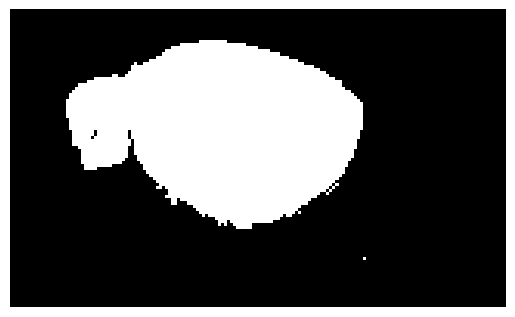

In [27]:
plt.imshow(ndi.rotate(mask_data_matlab[96], -90), cmap='bone')
plt.axis('off')
plt.show()

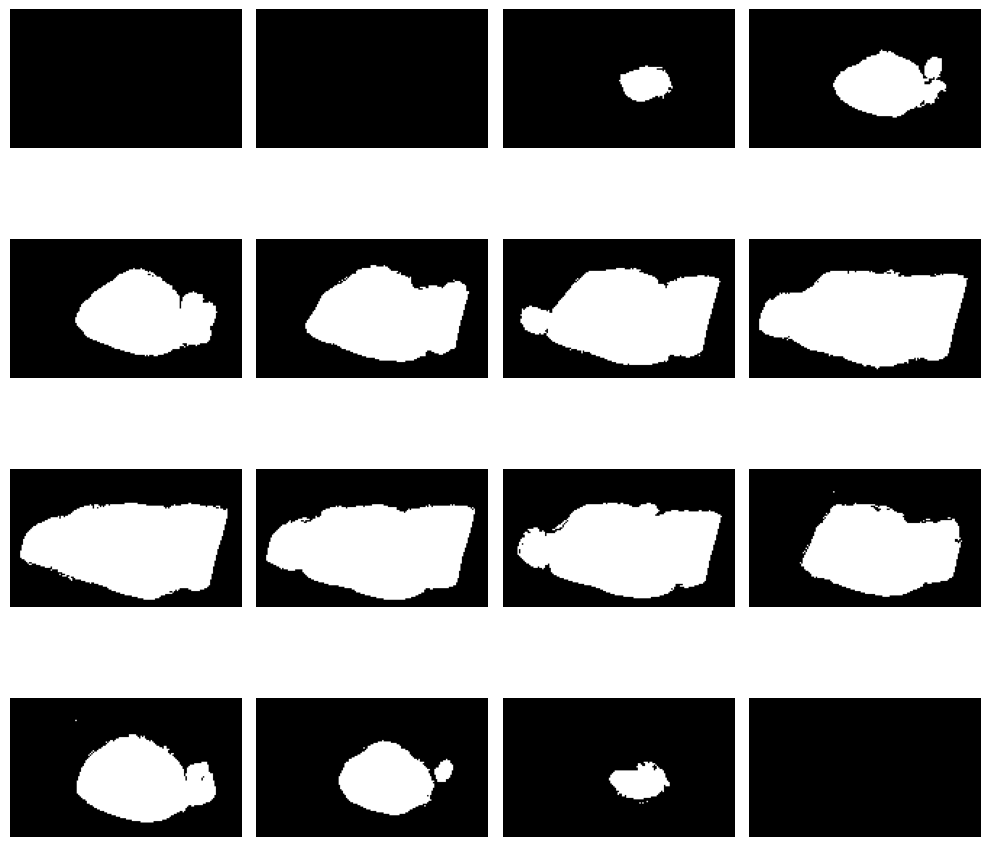

In [28]:
fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = mask_data_matlab.shape[0]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size
start_stop = int((n_slice - plot_range) / 2)

fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[10, 10])

for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(ndi.rotate(mask_data_matlab[img, :, :], 90), cmap='gray')
    axs.flat[idx].axis('off')
        
plt.tight_layout()
plt.show()

# Applying transformation

In [12]:
mask_img.affine = raw_img.affine

AttributeError: can't set attribute 'affine'

In [19]:
# getting mask data
mask_data = mask_img.get_fdata()
mask_data

memmap([[[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.]],

        ...,

        [[0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
         ...,
         [0., 0., 0., ..., 0., 0., 0.],
         [0., 0., 0., ..., 0., 0., 0.],
    

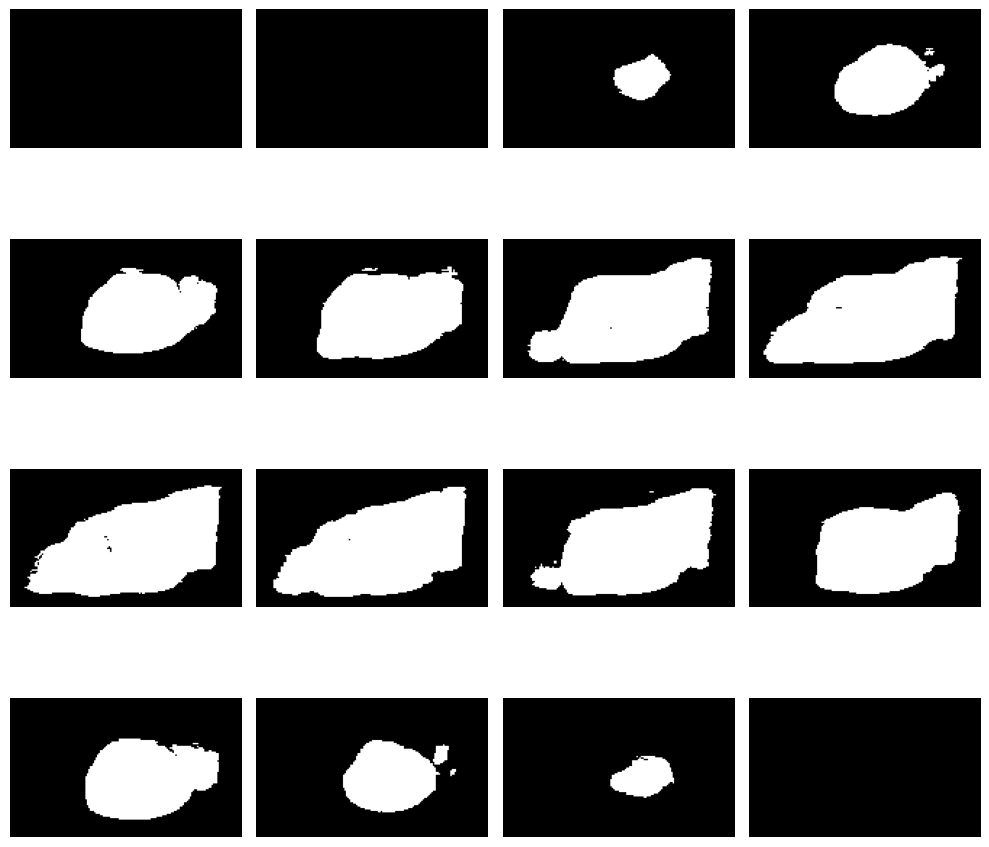

In [29]:
fig_rows = 4
fig_cols = 4
n_subplots = fig_rows * fig_cols
n_slice = mask_data.shape[0]
step_size = n_slice // n_subplots
plot_range = n_subplots * step_size
start_stop = int((n_slice - plot_range) / 2)

fig, axs = plt.subplots(fig_rows, fig_cols, figsize=[10, 10])

for idx, img in enumerate(range(start_stop, plot_range, step_size)):
    axs.flat[idx].imshow(ndi.rotate(mask_data[img, :, :], 90), cmap='gray')
    axs.flat[idx].axis('off')
        
plt.tight_layout()
plt.show()

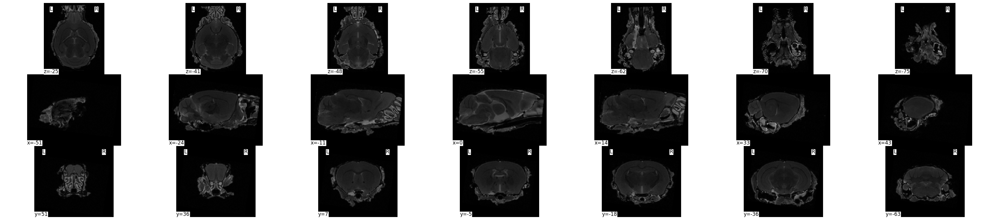

In [34]:
plotting.plot_img(raw_img, display_mode='mosaic', cmap='gray')
plt.show()

In [20]:
raw_img_data = raw_img.get_fdata()
raw_img_data

array([[[4.58827211, 2.1426365 , 0.80078334, ..., 1.88292299,
         2.44563561, 3.05163381],
        [4.9345568 , 3.85241715, 0.3029991 , ..., 3.93898832,
         4.0039167 , 4.48005814],
        [6.34133834, 5.86519689, 5.97341086, ..., 0.9306401 ,
         4.54498652, 4.28527301],
        ...,
        [4.43677256, 3.63598922, 1.73142344, ..., 7.16376447,
         3.09491939, 4.78305725],
        [4.06884508, 3.24641895, 4.17705904, ..., 7.51004916,
         3.74420318, 4.58827211],
        [4.50170094, 4.26363022, 3.05163381, ..., 5.02112797,
         3.80913156, 2.35906443]],

       [[1.55828109, 2.94341984, 3.72256039, ..., 3.15984777,
         4.09048787, 3.59270363],
        [5.45398383, 3.85241715, 3.00834822, ..., 2.83520588,
         3.33299012, 5.04277076],
        [4.22034463, 4.35020139, 2.72699191, ..., 3.83077436,
         3.05163381, 3.76584598],
        ...,
        [4.95619959, 2.05606533, 1.81799461, ..., 4.45841535,
         3.13820498, 4.54498652],
        [3.0

In [16]:
non_zero_coords = np.nonzero(mask_data)
non_zero_coords

(array([ 13,  13,  13, ..., 115, 116, 116]),
 array([ 94,  94,  94, ..., 111,  89,  97]),
 array([44, 45, 48, ..., 47, 40, 40]))

In [18]:
for coord in zip(*non_zero_coords):
    print(f"Coordinates: {coord}, Value: {mask_data[coord]}")

Coordinates: (13, 94, 44), Value: 1.0
Coordinates: (13, 94, 45), Value: 1.0
Coordinates: (13, 94, 48), Value: 1.0
Coordinates: (13, 95, 43), Value: 1.0
Coordinates: (13, 95, 44), Value: 1.0
Coordinates: (13, 95, 45), Value: 1.0
Coordinates: (13, 96, 43), Value: 1.0
Coordinates: (13, 96, 44), Value: 1.0
Coordinates: (13, 96, 45), Value: 1.0
Coordinates: (13, 97, 42), Value: 1.0
Coordinates: (13, 97, 43), Value: 1.0
Coordinates: (13, 97, 44), Value: 1.0
Coordinates: (13, 97, 45), Value: 1.0
Coordinates: (13, 97, 46), Value: 1.0
Coordinates: (13, 97, 48), Value: 1.0
Coordinates: (13, 98, 43), Value: 1.0
Coordinates: (13, 98, 44), Value: 1.0
Coordinates: (13, 98, 45), Value: 1.0
Coordinates: (13, 98, 46), Value: 1.0
Coordinates: (13, 98, 47), Value: 1.0
Coordinates: (13, 98, 48), Value: 1.0
Coordinates: (13, 99, 43), Value: 1.0
Coordinates: (13, 99, 44), Value: 1.0
Coordinates: (13, 99, 45), Value: 1.0
Coordinates: (13, 99, 46), Value: 1.0
Coordinates: (13, 99, 47), Value: 1.0
Coordinates: